In [1]:
import pandas as pd
from tqdm.auto import tqdm
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os
import sys
import warnings
warnings.filterwarnings('ignore')
sns.set_style('whitegrid')
tqdm.pandas()
# Path: environmental.ipynb

In [2]:
crashsite_df = pd.read_csv("data/Road_Crashes_for_five_Years_Victoria.csv",parse_dates=["ACCIDENT_DATE"])
crashsite_df.head()


,X,Y,OBJECTID,ACCIDENT_NO,ABS_CODE,ACCIDENT_STATUS,ACCIDENT_DATE,ACCIDENT_TIME,ALCOHOLTIME,ACCIDENT_TYPE,...,DEG_URBAN_ALL,LGA_NAME_ALL,REGION_NAME_ALL,SRNS,SRNS_ALL,RMA,RMA_ALL,DIVIDED,DIVIDED_ALL,STAT_DIV_NAME
0,2444652.517,2369157.816,1,T20150013818,ABS to receive accident,Finished,2015-07-01 00:00:00+00:00,1899/12/30 05:15:00+00,Yes,Collision with a fixed object,...,LARGE_PROVINCIAL_CITIES,GEELONG,SOUTH WESTERN REGION,NaN,NaN,Local Road,Local Road,Undivided,Undivided,Country
1,2507053.522,2427188.691,2,T20150013844,ABS to receive accident,Finished,2015-07-01 00:00:00+00:00,1899/12/30 11:30:00+00,No,Collision with a fixed object,...,MELB_URBAN,WHITTLESEA,METROPOLITAN NORTH WEST REGION,C,C,Arterial Other,"Arterial Other,Local Road",Divided,"Undivided,Divided",Metro
2,2490706.473,2409439.682,3,T20150013854,ABS to receive accident,Finished,2015-07-01 00:00:00+00:00,1899/12/30 13:40:00+00,No,Collision with vehicle,...,MELB_URBAN,MARIBYRNONG,METROPOLITAN NORTH WEST REGION,NaN,NaN,Local Road,Local Road,Undivided,Undivided,Metro
3,2524370.961,2379929.797,4,T20150013897,Non ABS accident,Finished,2015-07-02 00:00:00+00:00,1899/12/30 10:31:00+00,No,Struck Pedestrian,...,MELB_URBAN,CASEY,METROPOLITAN SOUTH EAST REGION,NaN,NaN,NaN,NaN,NaN,NaN,Metro
4,2346439.879,2385852.164,5,T20150013907,ABS to receive accident,Finished,2015-07-02 00:00:00+00:00,1899/12/30 10:25:00+00,No,Vehicle overturned (no collision),...,RURAL_VICTORIA,CORANGAMITE,SOUTH WESTERN REGION,C,C,Arterial Other,Arterial Other,Undivided,Undivided,Country


# EDA
## 1. Basic information

In [3]:
crashsite_df.info()
crashsite_df.describe()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 60689 entries, 0 to 60688
Data columns (total 65 columns):
 #   Column             Non-Null Count  Dtype              
---  ------             --------------  -----              
 0   X                  60689 non-null  float64            
 1   Y                  60689 non-null  float64            
 2   OBJECTID           60689 non-null  int64              
 3   ACCIDENT_NO        60689 non-null  object             
 4   ABS_CODE           60689 non-null  object             
 5   ACCIDENT_STATUS    60689 non-null  object             
 6   ACCIDENT_DATE      60689 non-null  datetime64[ns, UTC]
 7   ACCIDENT_TIME      60689 non-null  object             
 8   ALCOHOLTIME        60689 non-null  object             
 9   ACCIDENT_TYPE      60689 non-null  object             
 10  DAY_OF_WEEK        58987 non-null  object             
 11  DCA_CODE           60689 non-null  object             
 12  HIT_RUN_FLAG       60689 non-null  object     

,X,Y,OBJECTID,NODE_ID,LONGITUDE,LATITUDE,VICGRID_X,VICGRID_Y,TOTAL_PERSONS,INJ_OR_FATAL,...,PED_CYCLIST_13_18,OLD_PEDESTRIAN,OLD_DRIVER,YOUNG_DRIVER,UNLICENCSED,NO_OF_VEHICLES,HEAVYVEHICLE,PASSENGERVEHICLE,MOTORCYCLE,PUBLICVEHICLE
count,6.068900e+04,6.068900e+04,60689.00000,60689.000000,60689.000000,60689.000000,6.068900e+04,6.068900e+04,60689.000000,60689.000000,...,60689.000000,60689.000000,60689.000000,60689.000000,60689.000000,60685.000000,60685.000000,60685.000000,60685.000000,60685.000000
mean,2.497358e+06,2.421922e+06,30345.00000,234411.896934,144.732945,-37.645751,2.497358e+06,2.421922e+06,2.351629,1.308211,...,0.015687,0.024139,0.070771,0.288949,0.034471,1.790854,0.046321,1.411815,0.155689,0.012441
std,7.430158e+04,6.436034e+04,17519.54958,140607.093121,5.949869,1.534793,7.430158e+04,6.436034e+04,1.511034,0.782798,...,0.130344,0.157615,0.262288,0.510743,0.183966,0.768843,0.222298,0.931609,0.372030,0.112028
min,2.128750e+06,2.274524e+06,1.00000,4.000000,-1.000000,-39.023993,2.128750e+06,2.274524e+06,1.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000
25%,2.485223e+06,2.393623e+06,15173.00000,51684.000000,144.830339,-37.957173,2.485223e+06,2.393623e+06,2.000000,1.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,1.000000,0.000000,0.000000
50%,2.501454e+06,2.409539e+06,30345.00000,303841.000000,145.015981,-37.814612,2.501454e+06,2.409539e+06,2.000000,1.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,2.000000,0.000000,1.000000,0.000000,0.000000
75%,2.518897e+06,2.423416e+06,45517.00000,326827.000000,145.214600,-37.689004,2.518897e+06,2.423416e+06,3.000000,1.000000,...,0.000000,0.000000,0.000000,1.000000,0.000000,2.000000,0.000000,2.000000,0.000000,0.000000
max,2.920148e+06,2.820900e+06,60689.00000,756136.000000,149.757513,-1.000000,2.920148e+06,2.820900e+06,89.000000,41.000000,...,5.000000,3.000000,3.000000,5.000000,2.000000,21.000000,4.000000,19.000000,5.000000,2.000000


Index(['ABS_CODE', 'ACCIDENT_STATUS', 'ALCOHOLTIME', 'ACCIDENT_TYPE',
       'DAY_OF_WEEK', 'HIT_RUN_FLAG', 'LIGHT_CONDITION', 'POLICE_ATTEND',
       'ROAD_GEOMETRY', 'SEVERITY', 'SPEED_ZONE', 'RUN_OFFROAD', 'NODE_TYPE',
       'REGION_NAME', 'TOTAL_PERSONS', 'INJ_OR_FATAL', 'FATALITY',
       'SERIOUSINJURY', 'OTHERINJURY', 'NONINJURED', 'MALES', 'FEMALES',
       'BICYCLIST', 'PASSENGER', 'DRIVER', 'PEDESTRIAN', 'PILLION', 'MOTORIST',
       'UNKNOWN', 'PED_CYCLIST_5_12', 'PED_CYCLIST_13_18', 'OLD_PEDESTRIAN',
       'OLD_DRIVER', 'YOUNG_DRIVER', 'ALCOHOL_RELATED', 'UNLICENCSED',
       'NO_OF_VEHICLES', 'HEAVYVEHICLE', 'PASSENGERVEHICLE', 'MOTORCYCLE',
       'PUBLICVEHICLE', 'DEG_URBAN_NAME', 'DEG_URBAN_ALL', 'REGION_NAME_ALL',
       'SRNS', 'SRNS_ALL', 'RMA', 'RMA_ALL', 'DIVIDED', 'DIVIDED_ALL',
       'STAT_DIV_NAME'],
      dtype='object')

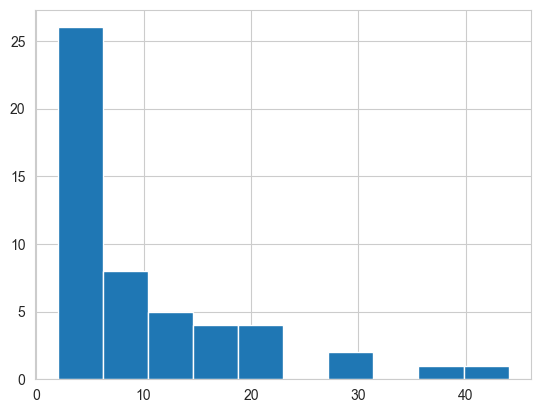

In [4]:
# crashsite_df.nunique(axis=0).hist() # this shows that the higher unique values are more than 60 
nunique = crashsite_df.nunique(axis=0)
nunique[nunique<60].hist()
nunique = nunique[nunique<60]
nunique.index

In [5]:
environmentalColumns = [ 'ALCOHOLTIME',
        'LIGHT_CONDITION',
       'ROAD_GEOMETRY', 'SPEED_ZONE',"RMA"
       ]

noneEnvironmentalColumns = crashsite_df.columns.difference(environmentalColumns)
noneEnvironmentalColumns

Index(['ABS_CODE', 'ACCIDENT_DATE', 'ACCIDENT_NO', 'ACCIDENT_STATUS',
       'ACCIDENT_TIME', 'ACCIDENT_TYPE', 'ALCOHOL_RELATED', 'BICYCLIST',
       'DAY_OF_WEEK', 'DCA_CODE', 'DEG_URBAN_ALL', 'DEG_URBAN_NAME', 'DIVIDED',
       'DIVIDED_ALL', 'DRIVER', 'FATALITY', 'FEMALES', 'HEAVYVEHICLE',
       'HIT_RUN_FLAG', 'INJ_OR_FATAL', 'LATITUDE', 'LGA_NAME', 'LGA_NAME_ALL',
       'LONGITUDE', 'MALES', 'MOTORCYCLE', 'MOTORIST', 'NODE_ID', 'NODE_TYPE',
       'NONINJURED', 'NO_OF_VEHICLES', 'OBJECTID', 'OLD_DRIVER',
       'OLD_PEDESTRIAN', 'OTHERINJURY', 'PASSENGER', 'PASSENGERVEHICLE',
       'PEDESTRIAN', 'PED_CYCLIST_13_18', 'PED_CYCLIST_5_12', 'PILLION',
       'POLICE_ATTEND', 'PUBLICVEHICLE', 'REGION_NAME', 'REGION_NAME_ALL',
       'RMA_ALL', 'RUN_OFFROAD', 'SERIOUSINJURY', 'SEVERITY', 'SRNS',
       'SRNS_ALL', 'STAT_DIV_NAME', 'TOTAL_PERSONS', 'UNKNOWN', 'UNLICENCSED',
       'VICGRID_X', 'VICGRID_Y', 'X', 'Y', 'YOUNG_DRIVER'],
      dtype='object')

In [7]:
import plotly.graph_objects as go

fig = go.Figure(data=[go.Pie(labels=environmentalColumns, values=nunique)])
fig.show()

In [6]:
import plotly.express as px
_df  = crashsite_df[environmentalColumns+["SEVERITY"]].copy()
_df = _df.dropna()
_df["count"] = 1

cols = environmentalColumns+["SEVERITY"]
fig = px.parallel_categories(_df, dimensions=cols)
# fig = px.sunburst(_df, path=cols,values="count")
fig.show()


In [7]:
# fig = px.violin(crashsite_df,x="ROAD_GEOMETRY", y="TOTAL_PERSONS")
# fig.show()

_df = crashsite_df.groupby("ROAD_GEOMETRY").agg({"TOTAL_PERSONS":"mean"}).sort_values(by="TOTAL_PERSONS",ascending=False)

fig = px.bar(
    _df,
    x=_df.index, 
    y="TOTAL_PERSONS",
    labels={"x":"ROAD GEOMETRY","y":"TOTAL PERSONS"}
    )
fig.show()

['Cross intersection', 'Multiple intersection', 'T intersection',
       'Y intersection', 'Not at intersection', 'Road closure', 'Dead end',
       'Unknown', 'Private property']

In [8]:
_df = crashsite_df.groupby("LIGHT_CONDITION").agg({"INJ_OR_FATAL":"mean"}).sort_values(by="INJ_OR_FATAL",ascending=False)
fig = px.bar(
    _df,
    x=_df.index, 
    y="INJ_OR_FATAL",
    labels={"x":"ROAD GEOMETRY","y":"TOTAL PERSONS"}
    )
fig.show()

In [9]:
crashsite_df["SEVERITY"]

0          Other injury accident
1          Other injury accident
2          Other injury accident
3          Other injury accident
4        Serious injury accident
                  ...           
60684      Other injury accident
60685      Other injury accident
60686      Other injury accident
60687    Serious injury accident
60688      Other injury accident
Name: SEVERITY, Length: 60689, dtype: object

In [16]:
#t-SNE
from sklearn.manifold import TSNE
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
#import one hot encoder
from sklearn.preprocessing import OneHotEncoder
# UMAP
import umap
sample = crashsite_df.sample(10000,random_state=0)


tsne = TSNE(
    n_components=3,  # 3 dimensional
    random_state=0, # set random state to 0 for reproducibility
    perplexity=50, # number of neighbors
    n_iter=5000, # number of iterations to run 
    n_jobs=-1 # use all cpu
    )
X = sample[environmentalColumns].copy()
X = pd.get_dummies(X)
# %time _X = fit.fit_transform(x)
%time X = tsne.fit_transform(X)
tsne_df = pd.DataFrame(X,columns=["x","y","z"])

CPU times: user 26min 55s, sys: 3min 59s, total: 30min 54s
Wall time: 4min 42s


In [17]:
fig = px.scatter_3d(
    tsne_df, 
    x='x', y='y', z='z',
    color=crashsite_df.loc[sample.index]["INJ_OR_FATAL"],
    opacity=0.2)
fig.update_layout(
    title="t-SNE of Environmental Features",
    scene = dict(
        xaxis_title='x',
        yaxis_title='y',
        zaxis_title='z'
    )
)
# adjust height
fig.update_layout(height=800)
fig.show()

from the chart above, we can says that there are clusters of environmental factors and it should be less than the number of total combination of each factors (`8190`). 

the next step is to apply DBSCAN clustering since we want to get the major cluster and ignore little noises

In [22]:
# DBSCAN
from sklearn.cluster import DBSCAN
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
import optuna



def objective(trial):
    eps = trial.suggest_float("eps", 5, 15)
    min_samples = trial.suggest_int("min_samples", 10, 50)

    params = {
        "eps":eps,
        "min_samples":min_samples
    }
    dbscan = DBSCAN(**params)
    dbscan.fit(tsne_df)
    labels = dbscan.labels_
    score = silhouette_score(tsne_df, labels)
    return score


params = None
params = {'eps': 9.598711878391601, 'min_samples': 14} # this is the best params from optuna 

if params is None:
    study = optuna.create_study(direction="maximize")
    study.optimize(objective, n_trials=50)
    best_trial = study.best_trial
    # params = best_trial.params
print(params)

{'eps': 9.598711878391601, 'min_samples': 14}


In [32]:

dbscan = DBSCAN(
    eps=params["eps"], 
    min_samples=int(params["min_samples"]))
dbscan.fit(tsne_df)
labels = dbscan.labels_
score = silhouette_score(tsne_df, labels)
tsne_df["labels"] = labels.astype(str) # convert to string for plotly
fig = px.scatter_3d(
    tsne_df,
    x='x', y='y', z='z',
    color='labels',
    opacity=0.2)
fig.update_layout(
    title="DBSCAN of Environmental Features",
    scene = dict(
        xaxis_title='x',
        yaxis_title='y',
        zaxis_title='z'
    ),
    height=800
)

fig.show()
#save as parquet
tsne_df.to_parquet("out/tsne_df_10K.parquet")# save as parquet
tsne_df.to_csv("out/tsne_df_10K.csv")# save as csv



In [24]:

print(crashsite_df[environmentalColumns].nunique())
print(f"number of combinations {2*7*9*13*5}")
print(f"number of clusters {len(np.unique(labels))}")

ALCOHOLTIME         2
LIGHT_CONDITION     7
ROAD_GEOMETRY       9
SPEED_ZONE         13
RMA                 5
dtype: int64
number of combinations 8190
number of clusters 161


In [25]:
sample["cluster"] =dbscan.labels_
sample["cluster"] = sample["cluster"].astype(str)

fig = px.parallel_categories(sample, dimensions=environmentalColumns)
fig.show()

In [23]:
# bar chart of cluster
_df = sample.groupby("cluster").agg({"TOTAL_PERSONS":"mean","INJ_OR_FATAL":"mean"}).sort_values(by="TOTAL_PERSONS",ascending=False)


fig = px.scatter(
    _df,
    x="TOTAL_PERSONS",
    y="INJ_OR_FATAL",
    color=_df.index,
    labels={"x":"TOTAL PERSONS","y":"INJ OR FATAL"}
    )

# draw median line for x and y
fig.add_shape(
    type="line",
    x0=_df["TOTAL_PERSONS"].median(),
    y0=0,
    x1=_df["TOTAL_PERSONS"].median(),
    y1=_df["INJ_OR_FATAL"].max(),
    line=dict(
        color="LightSeaGreen",
        width=4,
        dash="dashdot",
    )
)

fig.add_shape(
    type="line",
    x0=0,
    y0=_df["INJ_OR_FATAL"].median(),
    x1=_df["TOTAL_PERSONS"].max(),
    y1=_df["INJ_OR_FATAL"].median(),
    line=dict(
        color="LightSeaGreen",
        width=4,
        dash="dashdot",
    )
)
fig.update_layout(
    title="Cluster Analysis of Environmental Features",
    height=800
    
    )
fig.show()

In [26]:
# violin plot of cluster
fig = px.violin(
    sample,
    x="cluster",
    y="TOTAL_PERSONS",
    color="cluster",
    box=True,
    points="all",
    labels={"x":"cluster","y":"TOTAL PERSONS"}
    )
fig.update_layout(
    title="Cluster Analysis of Environmental Features",
    height=800)

In [27]:
#random forest classifier to predict cluster

from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report
# one hot encoding
from sklearn.preprocessing import OneHotEncoder

ohe = OneHotEncoder(handle_unknown='ignore').fit(sample[environmentalColumns].copy().dropna())

X = sample[environmentalColumns].copy()

X = ohe.transform(X)
# X = pd.get_dummies(X)
y = sample["cluster"].astype(str)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state=0)

rf = RandomForestClassifier(n_estimators=10, max_depth=12,random_state=0,)
rf.fit(X_train, y_train)
y_pred = rf.predict(X_test)
print(accuracy_score(y_test, y_pred))

print(classification_report(y_test, y_pred))


0.8775757575757576
              precision    recall  f1-score   support

          -1       0.85      0.85      0.85       375
           0       1.00      1.00      1.00        13
           1       0.78      0.97      0.86        36
          10       1.00      1.00      1.00         8
         100       1.00      0.80      0.89         5
         101       0.79      1.00      0.88        15
         102       1.00      0.67      0.80         3
         103       0.82      0.82      0.82        11
         104       1.00      1.00      1.00         9
         105       0.97      1.00      0.99        37
         106       0.83      1.00      0.91        15
         107       1.00      1.00      1.00        30
         108       1.00      1.00      1.00        13
         109       0.38      1.00      0.55        22
          11       1.00      1.00      1.00        10
         110       0.80      1.00      0.89         4
         111       1.00      0.80      0.89         5
        

In [25]:
# test score
print(f"test_score = {rf.score(X_test,y_test)}")

# train score
print(f"train_score = {rf.score(X_train,y_train)}")


test_score = 0.8775757575757576
train_score = 0.9056716417910448


In [23]:
# tune with optuna
import optuna
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import StratifiedKFold

def objective(trial):
    params = {
        'n_estimators': trial.suggest_int('n_estimators', 2, 100),
        'max_depth': trial.suggest_int('max_depth', 2, 32, log=True),
        'random_state': 0,
    }
    rf = RandomForestClassifier(**params)

    return cross_val_score(rf, X_train, y_train, n_jobs=-1, cv=StratifiedKFold()).mean()

study = optuna.create_study(direction='maximize')
study.optimize(objective, n_trials=100)


[I 2023-09-15 10:53:16,535] A new study created in memory with name: no-name-b81ef07a-f7b8-466a-8369-bf84384a458e
[I 2023-09-15 10:53:17,913] Trial 0 finished with value: 0.8840298507462687 and parameters: {'n_estimators': 38, 'max_depth': 17}. Best is trial 0 with value: 0.8840298507462687.
[I 2023-09-15 10:53:18,661] Trial 1 finished with value: 0.13417910447761194 and parameters: {'n_estimators': 59, 'max_depth': 2}. Best is trial 0 with value: 0.8840298507462687.
[I 2023-09-15 10:53:18,842] Trial 2 finished with value: 0.18970149253731344 and parameters: {'n_estimators': 61, 'max_depth': 3}. Best is trial 0 with value: 0.8840298507462687.
[I 2023-09-15 10:53:19,433] Trial 3 finished with value: 0.8870149253731343 and parameters: {'n_estimators': 88, 'max_depth': 14}. Best is trial 3 with value: 0.8870149253731343.
[I 2023-09-15 10:53:19,548] Trial 4 finished with value: 0.8819402985074628 and parameters: {'n_estimators': 15, 'max_depth': 16}. Best is trial 3 with value: 0.887014925

In [33]:
# best_params = study.best_params
best_params = {'n_estimators': 64, 'max_depth': 22}
print(best_params)

clf = RandomForestClassifier(**best_params)
clf.fit(X_train, y_train)
y_pred = clf.predict(X_test)
print(accuracy_score(y_test, y_pred))

print(classification_report(y_test, y_pred))

#logistic regression

{'n_estimators': 64, 'max_depth': 22}
0.8812121212121212
              precision    recall  f1-score   support

          -1       0.86      0.87      0.86       375
           0       1.00      1.00      1.00        13
           1       0.88      1.00      0.94        36
          10       1.00      1.00      1.00         8
         100       1.00      1.00      1.00         5
         101       0.94      1.00      0.97        15
         102       1.00      1.00      1.00         3
         103       1.00      0.91      0.95        11
         104       1.00      1.00      1.00         9
         105       1.00      1.00      1.00        37
         106       0.94      1.00      0.97        15
         107       1.00      1.00      1.00        30
         108       1.00      1.00      1.00        13
         109       0.38      1.00      0.55        22
          11       1.00      1.00      1.00        10
         110       0.80      1.00      0.89         4
         111       0.62 

In [34]:
crashsite_df["predicted_environmental_cluster"] = clf.predict(ohe.transform(crashsite_df[environmentalColumns],))
crashsite_df.to_parquet("out/crashsite_df_envcluster.parquet")

In [30]:
grouped = crashsite_df.groupby("predicted_environmental_cluster").agg(
    {
        "TOTAL_PERSONS":"mean",
        "INJ_OR_FATAL":"mean",
        "ACCIDENT_DATE":"count",
        "POLICE_ATTEND":lambda x: (x=="Yes").sum()/len(x),
        "SEVERITY": lambda x: (x=="Fatal accident").sum()/len(x),
        # "SEVERITY": lambda x: (x=="Serious injury accident").sum()/len(x)
        }

    ).sort_values(by="SEVERITY",ascending=False)

grouped.head()

,TOTAL_PERSONS,INJ_OR_FATAL,ACCIDENT_DATE,POLICE_ATTEND,SEVERITY
predicted_environmental_cluster,,,,,
130,3.168142,2.168142,113,0.902655,0.097345
29,1.537084,1.317136,391,0.846547,0.089514
49,2.020173,1.426513,347,0.907781,0.083573
77,1.966667,1.442857,210,0.876190,0.080952
67,2.191429,1.535714,700,0.928571,0.077143


In [32]:
fig = px.bar(
    grouped.drop("-1"),
    x=grouped.drop("-1").index,
    y="SEVERITY",
    labels={"x":"predicted_environmental_cluster","y":"SEVERITY"},
    color="ACCIDENT_DATE"
    )   
fig.update_layout(
    title="Predicted Environmental Cluster Analysis")

fig.show()

## serverity

the graph above shows that  `ALCOHOLTIME`, `LIGHT_CONDITION`, `ROAD_GEOMETRY`, `SPEED_ZONE`,`RMA` clustering have relationship to the serverity of the accident

being 

- `ALCOHOLTIME` : is allowed to serve alcohol
- `LIGHT_CONDITION` : lighting condition of the road
- `ROAD_GEOMETRY`: type of intersection, road
- `SPEED_ZONE`: speed limit of the zone
- `RMA`: additional type of road 


> next step would be exploring why each micro cluster have high serverity







In [33]:
environmentalColumns

['ALCOHOLTIME', 'LIGHT_CONDITION', 'ROAD_GEOMETRY', 'SPEED_ZONE', 'RMA']

In [34]:
# plot cluster on map with plotly

import plotly.express as px
import plotly.graph_objects as go

fig = px.scatter_mapbox(
    crashsite_df,
    lat="LATITUDE",
    lon="LONGITUDE",
    color="predicted_environmental_cluster",
    hover_name="ACCIDENT_NO",
    hover_data=environmentalColumns+["SEVERITY"],
    zoom=5,
    height=800,

    )
fig.update_layout(mapbox_style="open-street-map")
fig.show()

In [35]:
crashsite_df[crashsite_df["predicted_environmental_cluster"]=="130"][environmentalColumns].value_counts()

ALCOHOLTIME  LIGHT_CONDITION  ROAD_GEOMETRY       SPEED_ZONE  RMA       
No           Day              Cross intersection  100 km/hr   Local Road    113
Name: count, dtype: int64

In [36]:
crashsite_df[crashsite_df["predicted_environmental_cluster"]=="21"][environmentalColumns].value_counts()

ALCOHOLTIME  LIGHT_CONDITION             ROAD_GEOMETRY          SPEED_ZONE  RMA       
Yes          Dark Street lights on       Not at intersection    40 km/hr    Local Road    161
                                         Cross intersection     40 km/hr    Local Road    112
             Dusk/Dawn                   Cross intersection     40 km/hr    Local Road     26
             Dark Street lights on       Not at intersection    40 km/hr    Freeway        20
             Dark Street lights unknown  Cross intersection     40 km/hr    Local Road      6
             Unk.                        Cross intersection     40 km/hr    Local Road      6
             Dark Street lights on       Multiple intersection  40 km/hr    Local Road      3
                                         Cross intersection     40 km/hr    Freeway         2
                                         Private property       40 km/hr    Local Road      1
Name: count, dtype: int64

In [37]:
crashsite_df["ALCOHOLTIME"].value_counts()

ALCOHOLTIME
No     38752
Yes    21937
Name: count, dtype: int64

In [38]:
crashsite_df.head()

,X,Y,OBJECTID,ACCIDENT_NO,ABS_CODE,ACCIDENT_STATUS,ACCIDENT_DATE,ACCIDENT_TIME,ALCOHOLTIME,ACCIDENT_TYPE,...,LGA_NAME_ALL,REGION_NAME_ALL,SRNS,SRNS_ALL,RMA,RMA_ALL,DIVIDED,DIVIDED_ALL,STAT_DIV_NAME,predicted_environmental_cluster
0,2444652.517,2369157.816,1,T20150013818,ABS to receive accident,Finished,2015-07-01 00:00:00+00:00,1899/12/30 05:15:00+00,Yes,Collision with a fixed object,...,GEELONG,SOUTH WESTERN REGION,NaN,NaN,Local Road,Local Road,Undivided,Undivided,Country,39
1,2507053.522,2427188.691,2,T20150013844,ABS to receive accident,Finished,2015-07-01 00:00:00+00:00,1899/12/30 11:30:00+00,No,Collision with a fixed object,...,WHITTLESEA,METROPOLITAN NORTH WEST REGION,C,C,Arterial Other,"Arterial Other,Local Road",Divided,"Undivided,Divided",Metro,56
2,2490706.473,2409439.682,3,T20150013854,ABS to receive accident,Finished,2015-07-01 00:00:00+00:00,1899/12/30 13:40:00+00,No,Collision with vehicle,...,MARIBYRNONG,METROPOLITAN NORTH WEST REGION,NaN,NaN,Local Road,Local Road,Undivided,Undivided,Metro,87
3,2524370.961,2379929.797,4,T20150013897,Non ABS accident,Finished,2015-07-02 00:00:00+00:00,1899/12/30 10:31:00+00,No,Struck Pedestrian,...,CASEY,METROPOLITAN SOUTH EAST REGION,NaN,NaN,NaN,NaN,NaN,NaN,Metro,46
4,2346439.879,2385852.164,5,T20150013907,ABS to receive accident,Finished,2015-07-02 00:00:00+00:00,1899/12/30 10:25:00+00,No,Vehicle overturned (no collision),...,CORANGAMITE,SOUTH WESTERN REGION,C,C,Arterial Other,Arterial Other,Undivided,Undivided,Country,123


In [39]:
crashsite_df.to_csv("out/crashsite_df.csv",index=False)